In [1]:
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

from torch.autograd import Variable

from parameters import *
from dataloader_wikiart import *
from model_style import * 

In [2]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

# Create the dataloader
#dataset = StyleDataset()
#dataloader = DataLoader(dataset, batch_size, shuffle=True, num_workers=workers, pin_memory=True)
dataloader = get_dataset()

# Dataloader usage in training loop: 
# for i, (data, target, label) in enumerate(dataloader): data=image, target=onehot encoded style, label=style

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

Random Seed:  999


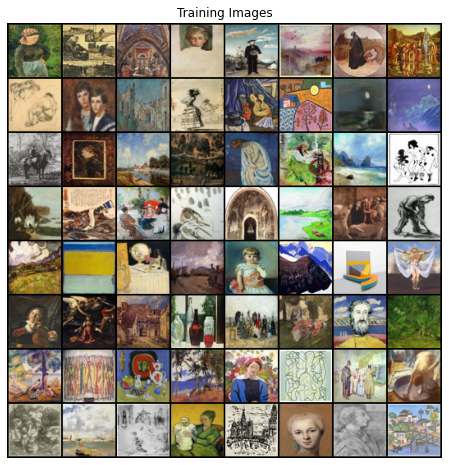

In [3]:
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# Create the generator
netG = Generator(ngpu).to(device)

# # Handle multi-gpu if desired
# if (device.type == 'cuda') and (ngpu > 1):
#     netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(150, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [5]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# # Handle multi-gpu if desired
# if (device.type == 'cuda') and (ngpu > 1):
#     netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (discriminate): Sequential(
    (0): Conv2d(256, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): Sigmoid()
  )
  (

In [6]:
# Initialize BCELoss function
criterion = nn.BCELoss()
criterion_style = nn.CrossEntropyLoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# adds gaussian noise
def gaussian(ins, mean, stddev):
    noise = Variable(ins.data.new(ins.size()).normal_(mean, stddev))
    return ins + noise

In [7]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
entropies = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, (data, style_label) in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        #target = target.to(device)
        style_label = style_label.to(device)
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output, output_style = netD(real_cpu, mean=0, stddev=0.5*0.01**(epoch/num_epochs))
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        errD_real = errD_real + criterion_style(output_style.squeeze(), style_label.squeeze())
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output, output_style = netD(fake.detach())
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output, output_style = netD(fake)
        # Uniform cross entropy
        logsoftmax = nn.LogSoftmax(dim=1)
        unif = torch.full((data.shape[0], n_class), 1/n_class)
        unif = unif.to(device)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        errG = errG + torch.mean(-torch.sum(unif * logsoftmax(output_style), 1))
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
         
        style_entropy = -1 * (nn.functional.softmax(output_style, dim=1) * nn.functional.log_softmax(output_style, dim=1))
        style_entropy = style_entropy.sum(dim=1).mean() / torch.log(torch.tensor(n_class).float())
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f\t Entropy: %.4f' 
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2, style_entropy))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        entropies.append(style_entropy)

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


/opt/conda/lib/python3.7/site-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([128])) that is different to the input size (torch.Size([128, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


[0/75][0/1413]	Loss_D: 4.5831	Loss_G: 5.1487	D(x): 0.3878	D(G(z)): 0.3316 / 0.2767	 Entropy: 0.8651
[0/75][50/1413]	Loss_D: 1.5863	Loss_G: 7.8289	D(x): 0.5910	D(G(z)): 0.4219 / 0.0385	 Entropy: 0.6137
[0/75][100/1413]	Loss_D: 0.9651	Loss_G: 9.4730	D(x): 0.7557	D(G(z)): 0.2111 / 0.0135	 Entropy: 0.4797
[0/75][150/1413]	Loss_D: 0.8057	Loss_G: 10.0114	D(x): 0.8101	D(G(z)): 0.1783 / 0.0140	 Entropy: 0.4118
[0/75][200/1413]	Loss_D: 0.6824	Loss_G: 9.6220	D(x): 0.8716	D(G(z)): 0.1183 / 0.0145	 Entropy: 0.4651
[0/75][250/1413]	Loss_D: 0.6250	Loss_G: 9.5308	D(x): 0.8990	D(G(z)): 0.0971 / 0.0144	 Entropy: 0.4763
[0/75][300/1413]	Loss_D: 1.1299	Loss_G: 8.6640	D(x): 0.6631	D(G(z)): 0.2829 / 0.1562	 Entropy: 0.3401
[0/75][350/1413]	Loss_D: 1.0858	Loss_G: 9.3151	D(x): 0.7200	D(G(z)): 0.2753 / 0.1323	 Entropy: 0.2862
[0/75][400/1413]	Loss_D: 1.1709	Loss_G: 9.9348	D(x): 0.6169	D(G(z)): 0.2546 / 0.1005	 Entropy: 0.2807
[0/75][450/1413]	Loss_D: 1.1796	Loss_G: 10.9592	D(x): 0.6922	D(G(z)): 0.2898 / 0.097

/opt/conda/lib/python3.7/site-packages/torch/nn/modules/loss.py:498: UserWarning: Using a target size (torch.Size([91])) that is different to the input size (torch.Size([91, 1, 1, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


[1/75][0/1413]	Loss_D: 1.1589	Loss_G: 14.9648	D(x): 0.7194	D(G(z)): 0.3822 / 0.0189	 Entropy: 0.1118
[1/75][50/1413]	Loss_D: 1.0009	Loss_G: 12.7267	D(x): 0.7345	D(G(z)): 0.3019 / 0.1452	 Entropy: 0.1488
[1/75][100/1413]	Loss_D: 1.0608	Loss_G: 13.0788	D(x): 0.7413	D(G(z)): 0.3342 / 0.1279	 Entropy: 0.1442
[1/75][150/1413]	Loss_D: 1.4971	Loss_G: 12.9766	D(x): 0.7071	D(G(z)): 0.4686 / 0.1097	 Entropy: 0.1334
[1/75][200/1413]	Loss_D: 0.8995	Loss_G: 12.7459	D(x): 0.7600	D(G(z)): 0.2953 / 0.1548	 Entropy: 0.1356
[1/75][250/1413]	Loss_D: 1.5992	Loss_G: 12.6590	D(x): 0.6202	D(G(z)): 0.4811 / 0.2239	 Entropy: 0.1554
[1/75][300/1413]	Loss_D: 1.3465	Loss_G: 12.7007	D(x): 0.6303	D(G(z)): 0.3068 / 0.1698	 Entropy: 0.1574
[1/75][350/1413]	Loss_D: 1.6701	Loss_G: 12.8057	D(x): 0.4841	D(G(z)): 0.3661 / 0.3052	 Entropy: 0.1270
[1/75][400/1413]	Loss_D: 1.2855	Loss_G: 12.5243	D(x): 0.5951	D(G(z)): 0.3301 / 0.2392	 Entropy: 0.1666
[1/75][450/1413]	Loss_D: 1.8892	Loss_G: 13.5100	D(x): 0.8209	D(G(z)): 0.7132

[3/75][1100/1413]	Loss_D: 1.9856	Loss_G: 15.2865	D(x): 0.3642	D(G(z)): 0.4175 / 0.4052	 Entropy: 0.1333
[3/75][1150/1413]	Loss_D: 1.6106	Loss_G: 15.0963	D(x): 0.5389	D(G(z)): 0.3617 / 0.2766	 Entropy: 0.1587
[3/75][1200/1413]	Loss_D: 2.1243	Loss_G: 15.5380	D(x): 0.3410	D(G(z)): 0.4455 / 0.3694	 Entropy: 0.1281
[3/75][1250/1413]	Loss_D: 1.6093	Loss_G: 15.6191	D(x): 0.4768	D(G(z)): 0.3932 / 0.3241	 Entropy: 0.1249
[3/75][1300/1413]	Loss_D: 1.8075	Loss_G: 15.4114	D(x): 0.6197	D(G(z)): 0.5345 / 0.3146	 Entropy: 0.1775
[3/75][1350/1413]	Loss_D: 1.4854	Loss_G: 15.4592	D(x): 0.6064	D(G(z)): 0.4503 / 0.3357	 Entropy: 0.1458
[3/75][1400/1413]	Loss_D: 1.4135	Loss_G: 15.6473	D(x): 0.6457	D(G(z)): 0.3828 / 0.2297	 Entropy: 0.1680
[4/75][0/1413]	Loss_D: 1.7243	Loss_G: 15.7031	D(x): 0.5441	D(G(z)): 0.4250 / 0.2930	 Entropy: 0.1507
[4/75][50/1413]	Loss_D: 1.6402	Loss_G: 15.4958	D(x): 0.4491	D(G(z)): 0.3905 / 0.3797	 Entropy: 0.1574
[4/75][100/1413]	Loss_D: 1.7864	Loss_G: 15.6584	D(x): 0.5869	D(G(z)):

[6/75][750/1413]	Loss_D: 1.7026	Loss_G: 17.5032	D(x): 0.5056	D(G(z)): 0.4760 / 0.3489	 Entropy: 0.1549
[6/75][800/1413]	Loss_D: 1.5020	Loss_G: 17.4840	D(x): 0.5974	D(G(z)): 0.3982 / 0.2635	 Entropy: 0.1177
[6/75][850/1413]	Loss_D: 1.6846	Loss_G: 17.3864	D(x): 0.5873	D(G(z)): 0.4750 / 0.3365	 Entropy: 0.1504
[6/75][900/1413]	Loss_D: 1.8747	Loss_G: 17.6023	D(x): 0.5981	D(G(z)): 0.5747 / 0.2648	 Entropy: 0.1587
[6/75][950/1413]	Loss_D: 0.4219	Loss_G: 11.1555	D(x): 0.9755	D(G(z)): 0.1518 / 0.0799	 Entropy: 0.2606
[6/75][1000/1413]	Loss_D: 0.4583	Loss_G: 11.6788	D(x): 0.9884	D(G(z)): 0.0199 / 0.0157	 Entropy: 0.2970
[6/75][1050/1413]	Loss_D: 0.3746	Loss_G: 12.1697	D(x): 0.9914	D(G(z)): 0.0143 / 0.0117	 Entropy: 0.2630
[6/75][1100/1413]	Loss_D: 0.4113	Loss_G: 13.7114	D(x): 0.9883	D(G(z)): 0.0028 / 0.0026	 Entropy: 0.2969
[6/75][1150/1413]	Loss_D: 0.2385	Loss_G: 12.8481	D(x): 0.9945	D(G(z)): 0.0081 / 0.0078	 Entropy: 0.2374
[6/75][1200/1413]	Loss_D: 0.3437	Loss_G: 12.3373	D(x): 0.9947	D(G(z))

[9/75][500/1413]	Loss_D: 0.3656	Loss_G: 15.8666	D(x): 0.9998	D(G(z)): 0.0004 / 0.0004	 Entropy: 0.2537
[9/75][550/1413]	Loss_D: 0.3953	Loss_G: 16.7129	D(x): 0.9999	D(G(z)): 0.0026 / 0.0022	 Entropy: 0.1839
[9/75][600/1413]	Loss_D: 0.3513	Loss_G: 15.9246	D(x): 0.9978	D(G(z)): 0.0024 / 0.0022	 Entropy: 0.2503
[9/75][650/1413]	Loss_D: 0.4230	Loss_G: 16.8116	D(x): 0.9964	D(G(z)): 0.0015 / 0.0014	 Entropy: 0.2275
[9/75][700/1413]	Loss_D: 0.3136	Loss_G: 17.3933	D(x): 0.9977	D(G(z)): 0.0001 / 0.0001	 Entropy: 0.2756
[9/75][750/1413]	Loss_D: 0.3834	Loss_G: 16.1211	D(x): 0.9972	D(G(z)): 0.0002 / 0.0002	 Entropy: 0.3127
[9/75][800/1413]	Loss_D: 0.1805	Loss_G: 14.8993	D(x): 0.9995	D(G(z)): 0.0005 / 0.0005	 Entropy: 0.3404
[9/75][850/1413]	Loss_D: 0.4032	Loss_G: 14.2554	D(x): 0.9996	D(G(z)): 0.0007 / 0.0007	 Entropy: 0.3701
[9/75][900/1413]	Loss_D: 0.3670	Loss_G: 15.5509	D(x): 0.9996	D(G(z)): 0.0004 / 0.0004	 Entropy: 0.2873
[9/75][950/1413]	Loss_D: 0.2765	Loss_G: 13.1408	D(x): 0.9997	D(G(z)): 0.0

[12/75][100/1413]	Loss_D: 1.1097	Loss_G: 21.6321	D(x): 0.7761	D(G(z)): 0.2779 / 0.1233	 Entropy: 0.1181
[12/75][150/1413]	Loss_D: 0.9213	Loss_G: 22.5720	D(x): 0.7610	D(G(z)): 0.1807 / 0.0741	 Entropy: 0.1201
[12/75][200/1413]	Loss_D: 1.6871	Loss_G: 22.5175	D(x): 0.9000	D(G(z)): 0.6165 / 0.0238	 Entropy: 0.1598
[12/75][250/1413]	Loss_D: 1.1911	Loss_G: 22.5527	D(x): 0.7855	D(G(z)): 0.3477 / 0.0826	 Entropy: 0.1229
[12/75][300/1413]	Loss_D: 0.9901	Loss_G: 21.8983	D(x): 0.7439	D(G(z)): 0.1963 / 0.0946	 Entropy: 0.1493
[12/75][350/1413]	Loss_D: 0.8851	Loss_G: 22.2777	D(x): 0.7444	D(G(z)): 0.1643 / 0.0614	 Entropy: 0.1171
[12/75][400/1413]	Loss_D: 1.1688	Loss_G: 23.0337	D(x): 0.8763	D(G(z)): 0.4429 / 0.0312	 Entropy: 0.1172
[12/75][450/1413]	Loss_D: 1.1696	Loss_G: 23.3598	D(x): 0.8806	D(G(z)): 0.4051 / 0.0265	 Entropy: 0.1214
[12/75][500/1413]	Loss_D: 1.7459	Loss_G: 24.5974	D(x): 0.8771	D(G(z)): 0.5755 / 0.0057	 Entropy: 0.1314
[12/75][550/1413]	Loss_D: 1.2915	Loss_G: 22.5759	D(x): 0.6218	D(

[14/75][1150/1413]	Loss_D: 0.7854	Loss_G: 25.5443	D(x): 0.8852	D(G(z)): 0.2058 / 0.0540	 Entropy: 0.1326
[14/75][1200/1413]	Loss_D: 1.5124	Loss_G: 25.0114	D(x): 0.4543	D(G(z)): 0.1201 / 0.4247	 Entropy: 0.1032
[14/75][1250/1413]	Loss_D: 1.3938	Loss_G: 25.4405	D(x): 0.7029	D(G(z)): 0.2972 / 0.0945	 Entropy: 0.1053
[14/75][1300/1413]	Loss_D: 1.0807	Loss_G: 24.6968	D(x): 0.6086	D(G(z)): 0.0888 / 0.2028	 Entropy: 0.1421
[14/75][1350/1413]	Loss_D: 0.9058	Loss_G: 26.0347	D(x): 0.9195	D(G(z)): 0.3472 / 0.0777	 Entropy: 0.1305
[14/75][1400/1413]	Loss_D: 1.1496	Loss_G: 25.5391	D(x): 0.6842	D(G(z)): 0.2291 / 0.1174	 Entropy: 0.1055
[15/75][0/1413]	Loss_D: 1.0052	Loss_G: 26.4447	D(x): 0.6283	D(G(z)): 0.0781 / 0.0791	 Entropy: 0.1007
[15/75][50/1413]	Loss_D: 1.2719	Loss_G: 26.2671	D(x): 0.8760	D(G(z)): 0.4102 / 0.0208	 Entropy: 0.0925
[15/75][100/1413]	Loss_D: 1.0516	Loss_G: 25.4707	D(x): 0.8190	D(G(z)): 0.3112 / 0.0660	 Entropy: 0.1107
[15/75][150/1413]	Loss_D: 0.8087	Loss_G: 24.7684	D(x): 0.7910

[17/75][750/1413]	Loss_D: 1.2549	Loss_G: 26.5608	D(x): 0.7511	D(G(z)): 0.3889 / 0.1155	 Entropy: 0.1239
[17/75][800/1413]	Loss_D: 1.2506	Loss_G: 26.2883	D(x): 0.7561	D(G(z)): 0.3549 / 0.1735	 Entropy: 0.1421
[17/75][850/1413]	Loss_D: 1.0542	Loss_G: 26.9914	D(x): 0.7119	D(G(z)): 0.2150 / 0.1181	 Entropy: 0.1119
[17/75][900/1413]	Loss_D: 1.2887	Loss_G: 26.2925	D(x): 0.5436	D(G(z)): 0.2584 / 0.3115	 Entropy: 0.0933
[17/75][950/1413]	Loss_D: 1.8586	Loss_G: 27.9101	D(x): 0.7741	D(G(z)): 0.5848 / 0.0502	 Entropy: 0.1230
[17/75][1000/1413]	Loss_D: 1.1944	Loss_G: 26.1800	D(x): 0.6780	D(G(z)): 0.2600 / 0.2537	 Entropy: 0.1344
[17/75][1050/1413]	Loss_D: 1.0050	Loss_G: 26.5267	D(x): 0.6514	D(G(z)): 0.1940 / 0.2262	 Entropy: 0.1072
[17/75][1100/1413]	Loss_D: 1.0964	Loss_G: 27.0366	D(x): 0.7848	D(G(z)): 0.2844 / 0.1014	 Entropy: 0.1402
[17/75][1150/1413]	Loss_D: 1.0650	Loss_G: 26.5762	D(x): 0.7540	D(G(z)): 0.3008 / 0.1451	 Entropy: 0.1262
[17/75][1200/1413]	Loss_D: 1.2164	Loss_G: 26.5570	D(x): 0.70

[20/75][350/1413]	Loss_D: 1.4105	Loss_G: 27.0836	D(x): 0.7489	D(G(z)): 0.3736 / 0.1564	 Entropy: 0.1304
[20/75][400/1413]	Loss_D: 1.1442	Loss_G: 27.0310	D(x): 0.7472	D(G(z)): 0.3726 / 0.1626	 Entropy: 0.1164
[20/75][450/1413]	Loss_D: 1.0742	Loss_G: 27.0403	D(x): 0.7185	D(G(z)): 0.2706 / 0.1373	 Entropy: 0.1359
[20/75][500/1413]	Loss_D: 0.9651	Loss_G: 27.5128	D(x): 0.7541	D(G(z)): 0.2504 / 0.1533	 Entropy: 0.1076
[20/75][550/1413]	Loss_D: 1.1246	Loss_G: 27.2202	D(x): 0.6735	D(G(z)): 0.2382 / 0.1534	 Entropy: 0.1351
[20/75][600/1413]	Loss_D: 1.1128	Loss_G: 26.9845	D(x): 0.6041	D(G(z)): 0.1597 / 0.1358	 Entropy: 0.1179
[20/75][650/1413]	Loss_D: 1.2437	Loss_G: 26.8280	D(x): 0.6365	D(G(z)): 0.2756 / 0.2571	 Entropy: 0.1266
[20/75][700/1413]	Loss_D: 1.3186	Loss_G: 27.6738	D(x): 0.8193	D(G(z)): 0.4479 / 0.0954	 Entropy: 0.1251
[20/75][750/1413]	Loss_D: 0.9679	Loss_G: 26.5925	D(x): 0.7372	D(G(z)): 0.2694 / 0.2167	 Entropy: 0.1374
[20/75][800/1413]	Loss_D: 1.2311	Loss_G: 27.1463	D(x): 0.7501	D(

[22/75][1400/1413]	Loss_D: 1.0460	Loss_G: 27.0560	D(x): 0.6517	D(G(z)): 0.2132 / 0.2528	 Entropy: 0.1063
[23/75][0/1413]	Loss_D: 1.4076	Loss_G: 27.8467	D(x): 0.8549	D(G(z)): 0.5234 / 0.0978	 Entropy: 0.1253
[23/75][50/1413]	Loss_D: 1.2257	Loss_G: 27.4995	D(x): 0.7971	D(G(z)): 0.4392 / 0.1608	 Entropy: 0.1137
[23/75][100/1413]	Loss_D: 1.3126	Loss_G: 26.7102	D(x): 0.5508	D(G(z)): 0.1698 / 0.3082	 Entropy: 0.1177
[23/75][150/1413]	Loss_D: 1.3577	Loss_G: 27.6316	D(x): 0.5512	D(G(z)): 0.2702 / 0.1790	 Entropy: 0.1180
[23/75][200/1413]	Loss_D: 1.0748	Loss_G: 27.5296	D(x): 0.6831	D(G(z)): 0.2326 / 0.1847	 Entropy: 0.1161
[23/75][250/1413]	Loss_D: 1.2573	Loss_G: 27.1379	D(x): 0.6245	D(G(z)): 0.2986 / 0.2800	 Entropy: 0.1310
[23/75][300/1413]	Loss_D: 1.3685	Loss_G: 27.4599	D(x): 0.7082	D(G(z)): 0.3428 / 0.1944	 Entropy: 0.1148
[23/75][350/1413]	Loss_D: 1.0162	Loss_G: 27.4456	D(x): 0.7865	D(G(z)): 0.3145 / 0.1623	 Entropy: 0.1258
[23/75][400/1413]	Loss_D: 1.2983	Loss_G: 27.3716	D(x): 0.7496	D(G(

[25/75][1000/1413]	Loss_D: 1.2592	Loss_G: 27.8209	D(x): 0.6087	D(G(z)): 0.2972 / 0.2776	 Entropy: 0.1153
[25/75][1050/1413]	Loss_D: 1.0681	Loss_G: 27.8540	D(x): 0.6930	D(G(z)): 0.2462 / 0.1807	 Entropy: 0.1251
[25/75][1100/1413]	Loss_D: 1.1987	Loss_G: 27.7343	D(x): 0.5519	D(G(z)): 0.1831 / 0.2520	 Entropy: 0.1132
[25/75][1150/1413]	Loss_D: 1.1774	Loss_G: 28.0393	D(x): 0.8045	D(G(z)): 0.3725 / 0.0972	 Entropy: 0.1634
[25/75][1200/1413]	Loss_D: 1.3867	Loss_G: 28.2271	D(x): 0.6823	D(G(z)): 0.3697 / 0.1535	 Entropy: 0.1259
[25/75][1250/1413]	Loss_D: 1.4274	Loss_G: 28.3848	D(x): 0.7175	D(G(z)): 0.4426 / 0.1667	 Entropy: 0.1128
[25/75][1300/1413]	Loss_D: 0.7816	Loss_G: 28.4097	D(x): 0.8551	D(G(z)): 0.3170 / 0.1339	 Entropy: 0.1097
[25/75][1350/1413]	Loss_D: 1.2812	Loss_G: 28.8318	D(x): 0.6801	D(G(z)): 0.3737 / 0.1734	 Entropy: 0.0884
[25/75][1400/1413]	Loss_D: 1.3545	Loss_G: 28.1589	D(x): 0.6973	D(G(z)): 0.4676 / 0.2134	 Entropy: 0.1114
[26/75][0/1413]	Loss_D: 1.1294	Loss_G: 27.5540	D(x): 0.

[28/75][600/1413]	Loss_D: 1.2120	Loss_G: 28.4796	D(x): 0.7922	D(G(z)): 0.4103 / 0.1000	 Entropy: 0.1134
[28/75][650/1413]	Loss_D: 1.2686	Loss_G: 28.7605	D(x): 0.8317	D(G(z)): 0.4537 / 0.0622	 Entropy: 0.1126
[28/75][700/1413]	Loss_D: 1.1330	Loss_G: 27.5550	D(x): 0.6640	D(G(z)): 0.2883 / 0.1651	 Entropy: 0.1153
[28/75][750/1413]	Loss_D: 1.0879	Loss_G: 27.5486	D(x): 0.6302	D(G(z)): 0.1875 / 0.1889	 Entropy: 0.1377
[28/75][800/1413]	Loss_D: 1.3967	Loss_G: 28.1470	D(x): 0.7084	D(G(z)): 0.4267 / 0.1933	 Entropy: 0.1075
[28/75][850/1413]	Loss_D: 1.1979	Loss_G: 28.6532	D(x): 0.6747	D(G(z)): 0.2731 / 0.1197	 Entropy: 0.1098
[28/75][900/1413]	Loss_D: 1.0361	Loss_G: 27.7154	D(x): 0.7364	D(G(z)): 0.2445 / 0.1889	 Entropy: 0.1302
[28/75][950/1413]	Loss_D: 1.2529	Loss_G: 28.2880	D(x): 0.7592	D(G(z)): 0.4351 / 0.1349	 Entropy: 0.1098
[28/75][1000/1413]	Loss_D: 1.2341	Loss_G: 27.3858	D(x): 0.5348	D(G(z)): 0.1620 / 0.2936	 Entropy: 0.1133
[28/75][1050/1413]	Loss_D: 1.0995	Loss_G: 28.0599	D(x): 0.6394	

[31/75][200/1413]	Loss_D: 0.9161	Loss_G: 28.3038	D(x): 0.7854	D(G(z)): 0.2557 / 0.1526	 Entropy: 0.1150
[31/75][250/1413]	Loss_D: 1.3047	Loss_G: 28.0874	D(x): 0.5404	D(G(z)): 0.0610 / 0.1684	 Entropy: 0.1074
[31/75][300/1413]	Loss_D: 1.1816	Loss_G: 27.6834	D(x): 0.8077	D(G(z)): 0.4431 / 0.1844	 Entropy: 0.1091
[31/75][350/1413]	Loss_D: 1.2033	Loss_G: 27.9934	D(x): 0.6801	D(G(z)): 0.2127 / 0.2404	 Entropy: 0.0983
[31/75][400/1413]	Loss_D: 0.9310	Loss_G: 28.2528	D(x): 0.8346	D(G(z)): 0.3260 / 0.1580	 Entropy: 0.0870
[31/75][450/1413]	Loss_D: 1.3398	Loss_G: 27.6400	D(x): 0.6295	D(G(z)): 0.3361 / 0.3162	 Entropy: 0.1178
[31/75][500/1413]	Loss_D: 1.0709	Loss_G: 27.7651	D(x): 0.6466	D(G(z)): 0.2004 / 0.2319	 Entropy: 0.1234
[31/75][550/1413]	Loss_D: 1.7409	Loss_G: 27.2124	D(x): 0.4706	D(G(z)): 0.2780 / 0.4731	 Entropy: 0.1257
[31/75][600/1413]	Loss_D: 1.2567	Loss_G: 27.6708	D(x): 0.7339	D(G(z)): 0.3997 / 0.2664	 Entropy: 0.1070
[31/75][650/1413]	Loss_D: 1.0762	Loss_G: 27.9791	D(x): 0.8232	D(

[33/75][1250/1413]	Loss_D: 0.9985	Loss_G: 27.8003	D(x): 0.6833	D(G(z)): 0.1944 / 0.2444	 Entropy: 0.1073
[33/75][1300/1413]	Loss_D: 1.2495	Loss_G: 27.6014	D(x): 0.5907	D(G(z)): 0.2871 / 0.3397	 Entropy: 0.1113
[33/75][1350/1413]	Loss_D: 0.8751	Loss_G: 28.5766	D(x): 0.8689	D(G(z)): 0.2476 / 0.1065	 Entropy: 0.1074
[33/75][1400/1413]	Loss_D: 1.0649	Loss_G: 27.8104	D(x): 0.6543	D(G(z)): 0.2300 / 0.1616	 Entropy: 0.1079
[34/75][0/1413]	Loss_D: 1.3073	Loss_G: 27.5107	D(x): 0.4875	D(G(z)): 0.0847 / 0.3024	 Entropy: 0.1027
[34/75][50/1413]	Loss_D: 1.1091	Loss_G: 27.7299	D(x): 0.7462	D(G(z)): 0.3636 / 0.2237	 Entropy: 0.1100
[34/75][100/1413]	Loss_D: 1.0662	Loss_G: 28.6849	D(x): 0.8220	D(G(z)): 0.4130 / 0.1095	 Entropy: 0.0978
[34/75][150/1413]	Loss_D: 1.1200	Loss_G: 27.3223	D(x): 0.6488	D(G(z)): 0.1913 / 0.2067	 Entropy: 0.0979
[34/75][200/1413]	Loss_D: 1.0200	Loss_G: 28.4989	D(x): 0.7557	D(G(z)): 0.1533 / 0.1197	 Entropy: 0.1213
[34/75][250/1413]	Loss_D: 1.0804	Loss_G: 28.2751	D(x): 0.8719	D

[36/75][850/1413]	Loss_D: 0.9960	Loss_G: 28.6721	D(x): 0.7547	D(G(z)): 0.3022 / 0.1329	 Entropy: 0.1047
[36/75][900/1413]	Loss_D: 0.9714	Loss_G: 28.7979	D(x): 0.7794	D(G(z)): 0.2774 / 0.0990	 Entropy: 0.1037
[36/75][950/1413]	Loss_D: 1.0195	Loss_G: 28.4620	D(x): 0.8486	D(G(z)): 0.3720 / 0.1146	 Entropy: 0.1015
[36/75][1000/1413]	Loss_D: 1.5440	Loss_G: 27.3644	D(x): 0.4484	D(G(z)): 0.1073 / 0.3093	 Entropy: 0.1248
[36/75][1050/1413]	Loss_D: 1.3885	Loss_G: 28.6143	D(x): 0.6717	D(G(z)): 0.3004 / 0.2020	 Entropy: 0.1025
[36/75][1100/1413]	Loss_D: 1.0126	Loss_G: 28.0058	D(x): 0.7838	D(G(z)): 0.3725 / 0.1078	 Entropy: 0.1030
[36/75][1150/1413]	Loss_D: 1.0546	Loss_G: 27.9179	D(x): 0.7417	D(G(z)): 0.2668 / 0.2325	 Entropy: 0.1112
[36/75][1200/1413]	Loss_D: 1.0702	Loss_G: 28.4242	D(x): 0.7855	D(G(z)): 0.3730 / 0.2070	 Entropy: 0.1052
[36/75][1250/1413]	Loss_D: 1.0253	Loss_G: 28.4877	D(x): 0.6830	D(G(z)): 0.2402 / 0.1724	 Entropy: 0.1003
[36/75][1300/1413]	Loss_D: 0.9169	Loss_G: 28.1520	D(x): 0.

[39/75][450/1413]	Loss_D: 0.7244	Loss_G: 28.9823	D(x): 0.8121	D(G(z)): 0.1419 / 0.1084	 Entropy: 0.0884
[39/75][500/1413]	Loss_D: 1.6185	Loss_G: 28.5621	D(x): 0.8534	D(G(z)): 0.5979 / 0.1763	 Entropy: 0.0973
[39/75][550/1413]	Loss_D: 0.8296	Loss_G: 28.2681	D(x): 0.7378	D(G(z)): 0.1585 / 0.2039	 Entropy: 0.1085
[39/75][600/1413]	Loss_D: 1.0443	Loss_G: 28.4182	D(x): 0.8057	D(G(z)): 0.3854 / 0.1887	 Entropy: 0.0914
[39/75][650/1413]	Loss_D: 0.9155	Loss_G: 28.4554	D(x): 0.7858	D(G(z)): 0.2180 / 0.1161	 Entropy: 0.1031
[39/75][700/1413]	Loss_D: 1.0815	Loss_G: 28.9739	D(x): 0.8722	D(G(z)): 0.3476 / 0.0886	 Entropy: 0.1280
[39/75][750/1413]	Loss_D: 1.0111	Loss_G: 29.1212	D(x): 0.7334	D(G(z)): 0.2121 / 0.0956	 Entropy: 0.1191
[39/75][800/1413]	Loss_D: 0.9492	Loss_G: 28.2737	D(x): 0.7158	D(G(z)): 0.1925 / 0.1845	 Entropy: 0.1007
[39/75][850/1413]	Loss_D: 1.0898	Loss_G: 29.4011	D(x): 0.8938	D(G(z)): 0.4261 / 0.0635	 Entropy: 0.1064
[39/75][900/1413]	Loss_D: 1.3562	Loss_G: 28.8504	D(x): 0.7645	D(

[42/75][50/1413]	Loss_D: 0.8778	Loss_G: 28.8521	D(x): 0.8005	D(G(z)): 0.2047 / 0.1657	 Entropy: 0.1054
[42/75][100/1413]	Loss_D: 0.9732	Loss_G: 28.7744	D(x): 0.7260	D(G(z)): 0.1842 / 0.1368	 Entropy: 0.0966
[42/75][150/1413]	Loss_D: 0.7477	Loss_G: 28.7302	D(x): 0.8188	D(G(z)): 0.1986 / 0.1283	 Entropy: 0.1129
[42/75][200/1413]	Loss_D: 0.8972	Loss_G: 29.3539	D(x): 0.8867	D(G(z)): 0.2993 / 0.0668	 Entropy: 0.0952
[42/75][250/1413]	Loss_D: 0.9675	Loss_G: 29.3430	D(x): 0.8762	D(G(z)): 0.3631 / 0.0796	 Entropy: 0.0979
[42/75][300/1413]	Loss_D: 0.7666	Loss_G: 28.7514	D(x): 0.7569	D(G(z)): 0.1823 / 0.1365	 Entropy: 0.1079
[42/75][350/1413]	Loss_D: 1.1966	Loss_G: 28.2658	D(x): 0.5508	D(G(z)): 0.1993 / 0.3219	 Entropy: 0.1148
[42/75][400/1413]	Loss_D: 0.9453	Loss_G: 29.2703	D(x): 0.8151	D(G(z)): 0.3320 / 0.1596	 Entropy: 0.0883
[42/75][450/1413]	Loss_D: 1.1130	Loss_G: 27.5552	D(x): 0.5987	D(G(z)): 0.1798 / 0.3084	 Entropy: 0.1264
[42/75][500/1413]	Loss_D: 0.8478	Loss_G: 28.4084	D(x): 0.7323	D(G

[44/75][1100/1413]	Loss_D: 1.0913	Loss_G: 28.5537	D(x): 0.5849	D(G(z)): 0.1208 / 0.1868	 Entropy: 0.0931
[44/75][1150/1413]	Loss_D: 0.7742	Loss_G: 29.4507	D(x): 0.6267	D(G(z)): 0.0232 / 0.0956	 Entropy: 0.0773
[44/75][1200/1413]	Loss_D: 0.9022	Loss_G: 29.1551	D(x): 0.7144	D(G(z)): 0.1751 / 0.2167	 Entropy: 0.0915
[44/75][1250/1413]	Loss_D: 0.7827	Loss_G: 29.9767	D(x): 0.8836	D(G(z)): 0.3086 / 0.0978	 Entropy: 0.0659
[44/75][1300/1413]	Loss_D: 1.4781	Loss_G: 29.9436	D(x): 0.8517	D(G(z)): 0.5769 / 0.0924	 Entropy: 0.0856
[44/75][1350/1413]	Loss_D: 0.9610	Loss_G: 28.8365	D(x): 0.7768	D(G(z)): 0.2723 / 0.1613	 Entropy: 0.1052
[44/75][1400/1413]	Loss_D: 0.8786	Loss_G: 28.6977	D(x): 0.7563	D(G(z)): 0.1883 / 0.2309	 Entropy: 0.0897
[45/75][0/1413]	Loss_D: 0.7985	Loss_G: 29.6277	D(x): 0.7009	D(G(z)): 0.0583 / 0.0986	 Entropy: 0.0805
[45/75][50/1413]	Loss_D: 1.3275	Loss_G: 29.7780	D(x): 0.8376	D(G(z)): 0.5009 / 0.0527	 Entropy: 0.0984
[45/75][100/1413]	Loss_D: 0.8287	Loss_G: 29.7756	D(x): 0.892

[47/75][700/1413]	Loss_D: 0.8208	Loss_G: 29.4753	D(x): 0.7977	D(G(z)): 0.2149 / 0.1658	 Entropy: 0.1053
[47/75][750/1413]	Loss_D: 0.8565	Loss_G: 29.4748	D(x): 0.7713	D(G(z)): 0.2285 / 0.1504	 Entropy: 0.0782
[47/75][800/1413]	Loss_D: 0.6741	Loss_G: 29.3896	D(x): 0.8208	D(G(z)): 0.1896 / 0.1929	 Entropy: 0.0816
[47/75][850/1413]	Loss_D: 0.8751	Loss_G: 29.5265	D(x): 0.8363	D(G(z)): 0.2665 / 0.1416	 Entropy: 0.0753
[47/75][900/1413]	Loss_D: 0.8230	Loss_G: 28.8947	D(x): 0.8966	D(G(z)): 0.2563 / 0.1654	 Entropy: 0.0967
[47/75][950/1413]	Loss_D: 0.9575	Loss_G: 29.4634	D(x): 0.7546	D(G(z)): 0.2654 / 0.1786	 Entropy: 0.0937
[47/75][1000/1413]	Loss_D: 0.9570	Loss_G: 29.0543	D(x): 0.6877	D(G(z)): 0.2188 / 0.1658	 Entropy: 0.1055
[47/75][1050/1413]	Loss_D: 0.9492	Loss_G: 29.2801	D(x): 0.6259	D(G(z)): 0.0927 / 0.1818	 Entropy: 0.0898
[47/75][1100/1413]	Loss_D: 1.0201	Loss_G: 28.3648	D(x): 0.6553	D(G(z)): 0.1428 / 0.2594	 Entropy: 0.0943
[47/75][1150/1413]	Loss_D: 0.8588	Loss_G: 29.6825	D(x): 0.882

[50/75][300/1413]	Loss_D: 0.6752	Loss_G: 28.8974	D(x): 0.8387	D(G(z)): 0.1460 / 0.1823	 Entropy: 0.1101
[50/75][350/1413]	Loss_D: 0.7501	Loss_G: 29.7950	D(x): 0.7843	D(G(z)): 0.2469 / 0.1676	 Entropy: 0.0720
[50/75][400/1413]	Loss_D: 1.0169	Loss_G: 29.5870	D(x): 0.5890	D(G(z)): 0.0808 / 0.1439	 Entropy: 0.0742
[50/75][450/1413]	Loss_D: 0.5509	Loss_G: 30.0384	D(x): 0.7580	D(G(z)): 0.0345 / 0.0725	 Entropy: 0.0654
[50/75][500/1413]	Loss_D: 0.9737	Loss_G: 30.3206	D(x): 0.8756	D(G(z)): 0.3535 / 0.0950	 Entropy: 0.0641
[50/75][550/1413]	Loss_D: 0.7890	Loss_G: 30.1995	D(x): 0.9072	D(G(z)): 0.3070 / 0.0661	 Entropy: 0.0760
[50/75][600/1413]	Loss_D: 0.7122	Loss_G: 29.6916	D(x): 0.7008	D(G(z)): 0.0485 / 0.1573	 Entropy: 0.0895
[50/75][650/1413]	Loss_D: 0.8778	Loss_G: 29.8587	D(x): 0.9455	D(G(z)): 0.3792 / 0.0805	 Entropy: 0.0838
[50/75][700/1413]	Loss_D: 0.8873	Loss_G: 29.9973	D(x): 0.6436	D(G(z)): 0.1318 / 0.1192	 Entropy: 0.0785
[50/75][750/1413]	Loss_D: 0.9926	Loss_G: 29.6748	D(x): 0.6169	D(

[52/75][1350/1413]	Loss_D: 0.7320	Loss_G: 29.8672	D(x): 0.8017	D(G(z)): 0.1444 / 0.1422	 Entropy: 0.0811
[52/75][1400/1413]	Loss_D: 0.7421	Loss_G: 30.2067	D(x): 0.8856	D(G(z)): 0.2504 / 0.0805	 Entropy: 0.0708
[53/75][0/1413]	Loss_D: 0.7571	Loss_G: 30.7109	D(x): 0.8838	D(G(z)): 0.2878 / 0.0892	 Entropy: 0.0919
[53/75][50/1413]	Loss_D: 0.9576	Loss_G: 29.0095	D(x): 0.6200	D(G(z)): 0.0565 / 0.2580	 Entropy: 0.0888
[53/75][100/1413]	Loss_D: 0.7293	Loss_G: 29.1998	D(x): 0.7277	D(G(z)): 0.0889 / 0.1187	 Entropy: 0.1030
[53/75][150/1413]	Loss_D: 0.7899	Loss_G: 30.3761	D(x): 0.8851	D(G(z)): 0.2732 / 0.0965	 Entropy: 0.0774
[53/75][200/1413]	Loss_D: 0.6121	Loss_G: 30.3641	D(x): 0.9148	D(G(z)): 0.2227 / 0.0526	 Entropy: 0.0915
[53/75][250/1413]	Loss_D: 0.7634	Loss_G: 29.5038	D(x): 0.6876	D(G(z)): 0.0644 / 0.1512	 Entropy: 0.0804
[53/75][300/1413]	Loss_D: 0.9371	Loss_G: 30.3047	D(x): 0.8797	D(G(z)): 0.3615 / 0.1091	 Entropy: 0.1033
[53/75][350/1413]	Loss_D: 0.7061	Loss_G: 29.8333	D(x): 0.8607	D(G

[55/75][950/1413]	Loss_D: 0.9454	Loss_G: 29.7765	D(x): 0.6744	D(G(z)): 0.1915 / 0.2825	 Entropy: 0.0732
[55/75][1000/1413]	Loss_D: 0.8128	Loss_G: 31.1499	D(x): 0.9005	D(G(z)): 0.2631 / 0.0603	 Entropy: 0.0725
[55/75][1050/1413]	Loss_D: 0.6563	Loss_G: 30.9701	D(x): 0.8735	D(G(z)): 0.2249 / 0.0776	 Entropy: 0.0806
[55/75][1100/1413]	Loss_D: 0.5040	Loss_G: 30.7336	D(x): 0.9706	D(G(z)): 0.1486 / 0.0687	 Entropy: 0.0766
[55/75][1150/1413]	Loss_D: 1.1072	Loss_G: 30.6297	D(x): 0.9067	D(G(z)): 0.4501 / 0.0899	 Entropy: 0.0896
[55/75][1200/1413]	Loss_D: 0.8076	Loss_G: 30.0852	D(x): 0.6779	D(G(z)): 0.0652 / 0.1698	 Entropy: 0.0794
[55/75][1250/1413]	Loss_D: 0.6351	Loss_G: 30.1322	D(x): 0.8818	D(G(z)): 0.1639 / 0.1150	 Entropy: 0.0866
[55/75][1300/1413]	Loss_D: 0.8725	Loss_G: 30.0730	D(x): 0.7453	D(G(z)): 0.1825 / 0.1807	 Entropy: 0.0906
[55/75][1350/1413]	Loss_D: 0.6511	Loss_G: 31.1875	D(x): 0.8744	D(G(z)): 0.2273 / 0.0886	 Entropy: 0.0642
[55/75][1400/1413]	Loss_D: 0.7831	Loss_G: 30.7878	D(x): 

[58/75][550/1413]	Loss_D: 0.6175	Loss_G: 29.9059	D(x): 0.7647	D(G(z)): 0.0645 / 0.1950	 Entropy: 0.0947
[58/75][600/1413]	Loss_D: 1.0458	Loss_G: 30.3177	D(x): 0.5628	D(G(z)): 0.0299 / 0.1362	 Entropy: 0.0805
[58/75][650/1413]	Loss_D: 0.7052	Loss_G: 30.6138	D(x): 0.7914	D(G(z)): 0.1466 / 0.1663	 Entropy: 0.0782
[58/75][700/1413]	Loss_D: 0.6275	Loss_G: 29.2097	D(x): 0.7252	D(G(z)): 0.1160 / 0.2532	 Entropy: 0.0951
[58/75][750/1413]	Loss_D: 0.6403	Loss_G: 29.7277	D(x): 0.8518	D(G(z)): 0.2208 / 0.1527	 Entropy: 0.1059
[58/75][800/1413]	Loss_D: 0.8657	Loss_G: 31.0917	D(x): 0.7020	D(G(z)): 0.1441 / 0.1357	 Entropy: 0.0839
[58/75][850/1413]	Loss_D: 0.7059	Loss_G: 31.0836	D(x): 0.8320	D(G(z)): 0.1918 / 0.0803	 Entropy: 0.0677
[58/75][900/1413]	Loss_D: 0.6880	Loss_G: 31.3300	D(x): 0.9770	D(G(z)): 0.2527 / 0.0470	 Entropy: 0.1039
[58/75][950/1413]	Loss_D: 1.0588	Loss_G: 31.6153	D(x): 0.9060	D(G(z)): 0.4021 / 0.0201	 Entropy: 0.0925
[58/75][1000/1413]	Loss_D: 0.6359	Loss_G: 31.1996	D(x): 0.8096	D

[61/75][150/1413]	Loss_D: 0.8361	Loss_G: 30.9951	D(x): 0.6144	D(G(z)): 0.0227 / 0.0889	 Entropy: 0.0957
[61/75][200/1413]	Loss_D: 0.6215	Loss_G: 30.3194	D(x): 0.7441	D(G(z)): 0.0887 / 0.1544	 Entropy: 0.0734
[61/75][250/1413]	Loss_D: 0.6809	Loss_G: 31.4404	D(x): 0.7808	D(G(z)): 0.1310 / 0.0608	 Entropy: 0.0919
[61/75][300/1413]	Loss_D: 0.4303	Loss_G: 31.6826	D(x): 0.8805	D(G(z)): 0.1258 / 0.0505	 Entropy: 0.0799
[61/75][350/1413]	Loss_D: 0.7758	Loss_G: 30.8380	D(x): 0.7195	D(G(z)): 0.1227 / 0.2105	 Entropy: 0.0698
[61/75][400/1413]	Loss_D: 0.6616	Loss_G: 30.6615	D(x): 0.7947	D(G(z)): 0.1139 / 0.0847	 Entropy: 0.0751
[61/75][450/1413]	Loss_D: 0.7263	Loss_G: 29.9877	D(x): 0.8314	D(G(z)): 0.2294 / 0.1638	 Entropy: 0.0556
[61/75][500/1413]	Loss_D: 0.5358	Loss_G: 31.8302	D(x): 0.9322	D(G(z)): 0.1395 / 0.0524	 Entropy: 0.0758
[61/75][550/1413]	Loss_D: 0.8621	Loss_G: 29.1523	D(x): 0.5795	D(G(z)): 0.0068 / 0.1395	 Entropy: 0.0839
[61/75][600/1413]	Loss_D: 0.5803	Loss_G: 31.6590	D(x): 0.9260	D(

[63/75][1200/1413]	Loss_D: 0.7500	Loss_G: 31.1696	D(x): 0.8876	D(G(z)): 0.1859 / 0.0746	 Entropy: 0.1072
[63/75][1250/1413]	Loss_D: 1.0074	Loss_G: 29.7530	D(x): 0.6108	D(G(z)): 0.1492 / 0.4453	 Entropy: 0.0600
[63/75][1300/1413]	Loss_D: 0.6125	Loss_G: 30.9081	D(x): 0.8316	D(G(z)): 0.1508 / 0.2109	 Entropy: 0.0706
[63/75][1350/1413]	Loss_D: 0.7701	Loss_G: 31.8009	D(x): 0.9974	D(G(z)): 0.3376 / 0.0450	 Entropy: 0.0955
[63/75][1400/1413]	Loss_D: 0.6974	Loss_G: 30.6249	D(x): 0.8682	D(G(z)): 0.2104 / 0.1644	 Entropy: 0.1089
[64/75][0/1413]	Loss_D: 1.2283	Loss_G: 32.0970	D(x): 0.9405	D(G(z)): 0.5277 / 0.0487	 Entropy: 0.0759
[64/75][50/1413]	Loss_D: 0.9043	Loss_G: 33.5016	D(x): 0.9806	D(G(z)): 0.4351 / 0.0043	 Entropy: 0.0791
[64/75][100/1413]	Loss_D: 0.6491	Loss_G: 32.0195	D(x): 0.9189	D(G(z)): 0.1962 / 0.0591	 Entropy: 0.0786
[64/75][150/1413]	Loss_D: 1.3913	Loss_G: 28.5362	D(x): 0.4155	D(G(z)): 0.0113 / 0.4477	 Entropy: 0.0828
[64/75][200/1413]	Loss_D: 0.6633	Loss_G: 30.8721	D(x): 0.7610	

[66/75][800/1413]	Loss_D: 0.4920	Loss_G: 31.7007	D(x): 0.9021	D(G(z)): 0.0771 / 0.0643	 Entropy: 0.0890
[66/75][850/1413]	Loss_D: 0.4556	Loss_G: 33.0327	D(x): 0.9163	D(G(z)): 0.0829 / 0.0245	 Entropy: 0.0988
[66/75][900/1413]	Loss_D: 0.4845	Loss_G: 31.7675	D(x): 0.8804	D(G(z)): 0.1035 / 0.0903	 Entropy: 0.0828
[66/75][950/1413]	Loss_D: 0.7322	Loss_G: 32.4442	D(x): 0.9080	D(G(z)): 0.2410 / 0.0429	 Entropy: 0.0667
[66/75][1000/1413]	Loss_D: 0.6976	Loss_G: 32.1341	D(x): 0.7476	D(G(z)): 0.0146 / 0.0463	 Entropy: 0.0766
[66/75][1050/1413]	Loss_D: 0.5442	Loss_G: 30.9242	D(x): 0.7949	D(G(z)): 0.0433 / 0.2497	 Entropy: 0.0682
[66/75][1100/1413]	Loss_D: 0.4198	Loss_G: 32.0615	D(x): 0.9385	D(G(z)): 0.1454 / 0.0463	 Entropy: 0.0632
[66/75][1150/1413]	Loss_D: 0.8092	Loss_G: 32.5263	D(x): 0.9777	D(G(z)): 0.2978 / 0.0440	 Entropy: 0.0659
[66/75][1200/1413]	Loss_D: 0.6784	Loss_G: 30.9727	D(x): 0.7939	D(G(z)): 0.1411 / 0.1244	 Entropy: 0.0737
[66/75][1250/1413]	Loss_D: 0.5529	Loss_G: 32.4129	D(x): 0.9

[69/75][400/1413]	Loss_D: 0.6205	Loss_G: 31.9635	D(x): 0.8758	D(G(z)): 0.1326 / 0.1091	 Entropy: 0.0821
[69/75][450/1413]	Loss_D: 0.7367	Loss_G: 32.5359	D(x): 0.8673	D(G(z)): 0.2240 / 0.0643	 Entropy: 0.0866
[69/75][500/1413]	Loss_D: 0.5886	Loss_G: 32.2150	D(x): 0.7979	D(G(z)): 0.0439 / 0.0472	 Entropy: 0.0909
[69/75][550/1413]	Loss_D: 0.4245	Loss_G: 32.7876	D(x): 0.9899	D(G(z)): 0.1626 / 0.0167	 Entropy: 0.0713
[69/75][600/1413]	Loss_D: 0.4456	Loss_G: 31.6650	D(x): 0.8485	D(G(z)): 0.0508 / 0.0776	 Entropy: 0.0863
[69/75][650/1413]	Loss_D: 0.4007	Loss_G: 32.2252	D(x): 0.8758	D(G(z)): 0.0477 / 0.0372	 Entropy: 0.0772
[69/75][700/1413]	Loss_D: 0.6290	Loss_G: 31.5282	D(x): 0.7207	D(G(z)): 0.0356 / 0.0876	 Entropy: 0.0824
[69/75][750/1413]	Loss_D: 0.5174	Loss_G: 32.2298	D(x): 0.9468	D(G(z)): 0.1143 / 0.0474	 Entropy: 0.0811
[69/75][800/1413]	Loss_D: 0.7432	Loss_G: 30.2212	D(x): 0.7387	D(G(z)): 0.0676 / 0.2696	 Entropy: 0.0878
[69/75][850/1413]	Loss_D: 0.4700	Loss_G: 32.5228	D(x): 0.9512	D(

[72/75][0/1413]	Loss_D: 0.6820	Loss_G: 31.7422	D(x): 0.7294	D(G(z)): 0.0159 / 0.0535	 Entropy: 0.1108
[72/75][50/1413]	Loss_D: 0.4493	Loss_G: 32.6209	D(x): 0.9147	D(G(z)): 0.1088 / 0.0815	 Entropy: 0.0648
[72/75][100/1413]	Loss_D: 0.6825	Loss_G: 30.9682	D(x): 0.7021	D(G(z)): 0.0374 / 0.2219	 Entropy: 0.0627
[72/75][150/1413]	Loss_D: 0.6629	Loss_G: 31.8669	D(x): 0.7222	D(G(z)): 0.0248 / 0.1115	 Entropy: 0.0815
[72/75][200/1413]	Loss_D: 0.5316	Loss_G: 32.4659	D(x): 0.7234	D(G(z)): 0.0084 / 0.1019	 Entropy: 0.0567
[72/75][250/1413]	Loss_D: 0.5841	Loss_G: 31.4933	D(x): 0.8513	D(G(z)): 0.0783 / 0.1152	 Entropy: 0.0737
[72/75][300/1413]	Loss_D: 0.4703	Loss_G: 32.2511	D(x): 0.9687	D(G(z)): 0.1121 / 0.0666	 Entropy: 0.0886
[72/75][350/1413]	Loss_D: 0.3688	Loss_G: 33.8203	D(x): 0.9770	D(G(z)): 0.0991 / 0.0121	 Entropy: 0.0796
[72/75][400/1413]	Loss_D: 0.4027	Loss_G: 32.5743	D(x): 0.8901	D(G(z)): 0.1152 / 0.0721	 Entropy: 0.0652
[72/75][450/1413]	Loss_D: 0.3948	Loss_G: 32.9688	D(x): 0.9069	D(G(z

[74/75][1050/1413]	Loss_D: 0.3992	Loss_G: 32.4901	D(x): 0.9764	D(G(z)): 0.1040 / 0.0685	 Entropy: 0.0624
[74/75][1100/1413]	Loss_D: 0.2656	Loss_G: 28.5298	D(x): 0.9966	D(G(z)): 0.0008 / 0.0007	 Entropy: 0.0760
[74/75][1150/1413]	Loss_D: 0.1315	Loss_G: 25.6614	D(x): 0.9972	D(G(z)): 0.0028 / 0.0024	 Entropy: 0.0518
[74/75][1200/1413]	Loss_D: 0.2345	Loss_G: 18.2891	D(x): 0.9971	D(G(z)): 0.0052 / 0.0044	 Entropy: 0.1250
[74/75][1250/1413]	Loss_D: 0.2102	Loss_G: 20.5035	D(x): 0.9996	D(G(z)): 0.0077 / 0.0061	 Entropy: 0.0883
[74/75][1300/1413]	Loss_D: 0.2631	Loss_G: 13.7198	D(x): 0.9996	D(G(z)): 0.0068 / 0.0061	 Entropy: 0.2764
[74/75][1350/1413]	Loss_D: 0.1935	Loss_G: 13.3457	D(x): 0.9994	D(G(z)): 0.0067 / 0.0060	 Entropy: 0.3477
[74/75][1400/1413]	Loss_D: 0.1939	Loss_G: 12.3619	D(x): 0.9994	D(G(z)): 0.0083 / 0.0078	 Entropy: 0.5729


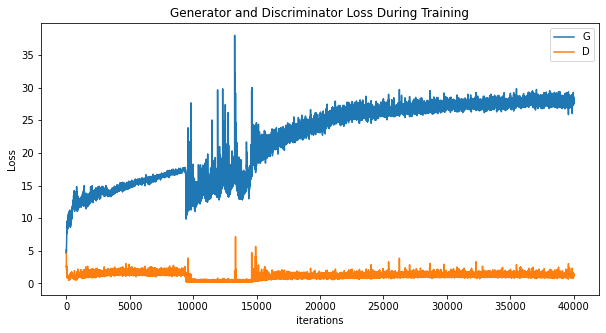

In [8]:
# Plot Losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses[:40000],label="G")
plt.plot(D_losses[:40000],label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

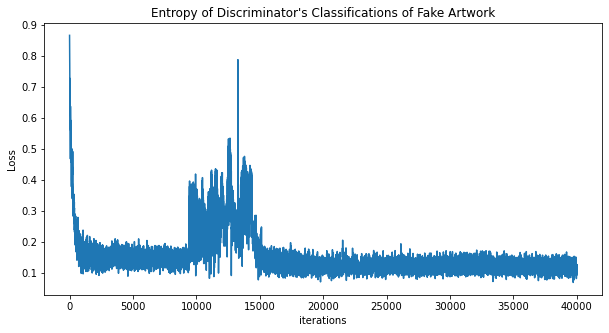

In [9]:
plt.figure(figsize=(10,5))
plt.title("Entropy of Discriminator's Classifications of Fake Artwork")
plt.plot(entropies[:40000])
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.show()

Animation size has reached 21203500 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


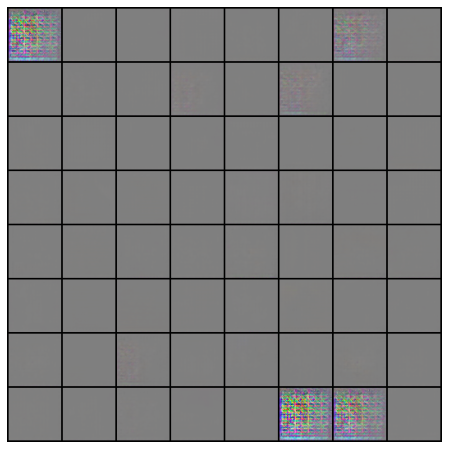

In [10]:
# Visualize G's Progress
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [11]:
len(img_list)

213

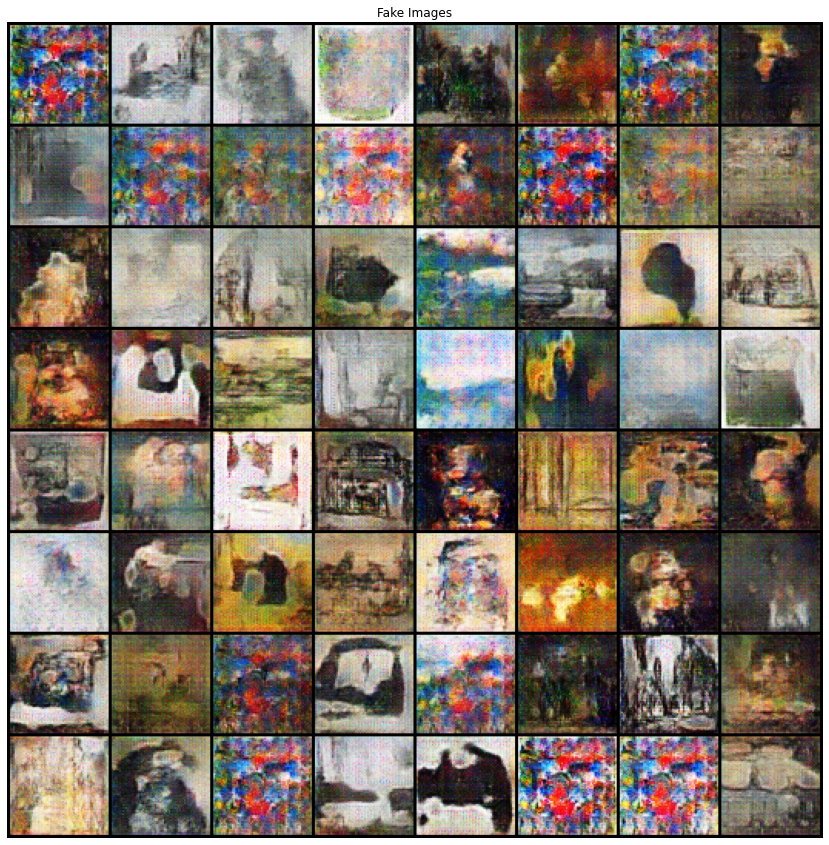

In [24]:
# Real vs Fake
# Grab a batch of real images from the dataloader
#real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
#plt.subplot(1,2,1)
#plt.axis("off")
#plt.title("Real Images")
#plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
#plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[70],(1,2,0)))
plt.show()